In [ ]:
%%capture
!pip install git+https://github.com/MaartenGr/BERTopic.git@master

!pip install cudf-cu12 dask-cudf-cu12 --extra-index-url=https://pypi.nvidia.com
!pip install cuml-cu12 --extra-index-url=https://pypi.nvidia.com
!pip install cugraph-cu12 --extra-index-url=https://pypi.nvidia.com
!pip install cupy-cuda12x -f https://pip.cupy.dev/aarch64

!pip install safetensors
!pip install datasets
!pip install datashader
!pip install adjustText

In [ ]:
import os
import re
import pandas as pd
from datetime import datetime

In [ ]:
from cuml.manifold import UMAP
from cuml.cluster import HDBSCAN
from bertopic import BERTopic

In [ ]:
# Set the directory path
directory = '/content/'

In [ ]:
# Get a list of CSV files in the directory
ico_files = [f for f in os.listdir(directory) if f.endswith('.csv')]

In [ ]:
# Initialize a variable to keep track of the total number of rows
total_rows = 0

# Iterate over each file
for filename in ico_files:
    # Read the CSV file
    file_path = os.path.join(directory, filename)
    data = pd.read_csv(file_path)

    # Get the number of rows in the current file and add it to the total count
    total_rows += len(data)

# Print the total number of rows
print("Total number of rows across all CSV files:", total_rows)

Total number of rows across all CSV files: 558806


In [ ]:
all_tweets = pd.DataFrame(columns=['created_at', 'text', 'ico'])

In [ ]:
import pandas as pd
import re

# Initialize an empty DataFrame for all tweets
all_tweets = pd.DataFrame()

for ico_file in ico_files:
    ico_name = ico_file.replace('.csv', '')
    ico_data = pd.read_csv(f'/content/{ico_file}')

    # Define the text cleaning function
    def clean_text(text):
        text = re.sub(r"http\S+", "", text).lower()
        text = " ".join(filter(lambda x: x[0] != "@", text.split()))
        text = " ".join(re.sub("[^a-zA-Z]+", " ", text).split())
        text = " ".join(word for word in text.split() if word not in ["mxgpportugal","th","brent","wells","oil","india","paul","ppc","gt","sp","txp","assetstream","loyaltyprotocol","president","war","onamtoken","onamtrading","onamexchange","onam","jse","idachain","animals","animal","sea","artwork","picoftheday","photography","athens","mxgpbulgaria","mxgpczechrepublic","mxgpbelgium","laptop","emx","mxgp","mx","mxgpczechrepublic","mxgp","dham","wardha","vena","macbook","laptopskins","laptops","supercars","muffle","audia","rallyforrivers","rallyfordhampaunarriver","rivers","muffler","audicars","engine","audis","racing","jaguarcars","gowithmi","valvetronic","guangdong","jiujiang","ss","tinnitus","sapphires","acropolis","greece","sounio","poetry","piercing","earcandy","withlove","curatedear","emeraldring","otoscope","leadupchat","wards","turbo","poem","decorate","baatgharkihai","decoration","wallsandflooring","building","tiles","buildingmaterial","bricks","xrm","xerium","xeriumtechnologies","pancreatic","diabetes","diabetescure","implanting","wallmurals","mural","walls","seawall","hoard","ingot","paling","aouni","slee","penis","milk","whoremanship","vertexplatform","vindax","vtex","orch","waka","pledgecamp","dprinting","dprinter","dprint","printing","printer","printers","prints","print","dprinted","kost","rumah","pesan","gedung","yanuico","homeopathic","dress","birth","acrylic","kuliner","kafe","banten","tangsel","rojas","ll","smokees","charsk","boutique","dallasboutique","teamsisd","fleta","students","teachers","school","coach","grade","denver","boise","charleston","reuters","indianapolis","sandeigo","winnest","erc","millennium","baltimore","imu","mtb","mountainbiking","faircoin","asa","mountainbike","christian","quran","allah","atheist","religion","almighty","prayer","faith","jehovah","pray","mw","godblessamerica","jibbit","jibbitico","jib","bitcanna","yourbilingualpartner","organs","cryptocean","elpis","bible","hc","verseoftheday","binax","ve","venusenergy","hho","cheer","bjj","vs","testaslifanska","viratkohli","rugby","ball","manchester","yang","allbebet","islam","celebrationservice","lord","rhemachapelhq","weworship","wepraise","sundaymorning","germany","srilanka","empire","uspoli","herero","adiabatic","usharjah","battleofsixes","testseries","bharatarmyawards","nz","mcg","bobcat","hello","greetings","aussie","instagood","gmbc","players","bitagro","st","indvpak","nzwvindw","kuldeep","mls","thelou","womencricket","xi","gc","ml","peter","tom","viariumproject","hey","kualalumpur","aditya","daniel","michael","brian","church","worship","atheism","christianity","hallelujah","yearofmakingadifference","sundayservice","germancrimes","german","germans","horrormovies","cultclassichorror","gop","presidenttrump","german","donaldtrump","reparations","cftw","electroneum","thecollectiveico","reparations","nra","clinton","germancrimes","cotinetwork","stumps","cdex","falcons","gobills","bbccricket","jews","september","cet","ben","belarus","overs","indiawomen","captain","rohit","toss","aussies","wwii","icoinindia","scott","stephen","nick","chris","andrew","david","tvnovosti","nazi","bobcats","mlb","dfs","women","baseball","squad","tournament","chase","league","rail","train","lights","station","stations","fairytale","bloodstream","railwayelectricalservices","railway","trains","antoinette","witchdoctor","quinn","patrickkavanagh","witch","rd","rbi","pt","sunex","yan","james","oceaniacruises","totems","furry","rpc","res","axl","necklace","pendant","wicca","fur","bracelet","shaman","lg","kw","ddg","iron","navy","chainlink","ae","huawei","xiaomi","ios","apple","permatavapestore","mfsk","khz","utc","zrx","xmr","pregnant","nurses","vaperbandung","vapestorecimahi","vapercimahi","vaper","tokovape","divorceattorney","attorneyadvertising","lawyeredup","druglawyer","divorce","maternity","respectfulmaternitycare","pregnancy","amharas","saudi","ethnic","farmers","macosmojave","macos","mojave","namibian","redc","bloody","nissan","amhara","ekkhwabzindagika","shubhbuild","genocide","skulls","holocaust","namibia","cc","meitu","sd","jaipur","cement","dodge","aclydproject","aclydrevolution","aclyd","xiaomi","xiaomimicc","radiobrunet","mustang","ferrari","volkswagen","audi","porsche","zenpp","pas","lci","lcp","rtl","kartichidambaram","chidambaram","inx","karti","cbi","delhi","plea","krzysztof","szwagrzyk","warsaw","polessavingjews","szpytma","startrek","kira","cock","cocking","pig","heta","menlo","polishhistory","poland","szarek","polish","temco","nextistemco","rsk","nexusone","bolttcoins","bolttcoin","nexusone","handmadejewelry","earrings","bst","metals","inx","atms","mliv","john","vanuatu","marijuana","showroom","showrooms","diamonds","lovegold","bracelet","gems","bracelets","ring","moolyaglobal","batsmen","batsman","inning","rahul","bowling","bts","vrx","ireland","lavishdinners","batting","bowled","bowlers","wicket","mixcloud","livemusic","govt","corrupt","corruption","politicians","cma","musicproducer","beats","rappers","soundcloudrapper","rap","remix","rapper","songs","iou","bartending","ce","viariumico","agric","farm","farmpartner","vid","iownbounty","idax","particl","txo","omni","yanu","iown","iowntoken","iouico","myo","vegawallet","ah","upxtoken","singular","abraaj","np","cma","earthcycle","hi","greenbusiness","brave","syria","putin","ukraine","genetherapy","spinraza","joseph","kapor","bitteam","tokenbitteam","cybervein","ipgold","diseases","orphandrugs","gastroparesis","curegp","parkinsons","amyloid","highbank","emercoin","numeraire","openanx","ygkeats","ygkfood","elink","uos","crypton","lewat","ltal","cez","korisnika","udapfoundation","rypt","scania","kansascity","moolyacoinpreico","rutx","px","fluzcoin","aizeus","zeus","irstcoin","wine","anthony","jual","kantor","sekolah","ac","hawknetwork","lcr","agrocoin","agroexchange","ilink","javvy","cargocoin","instabitcoin","yby","etainpower","pb","tge","wollo","wlo","elisia","avcjkorea","neluns","vtx","vidt","vortixmysafe","buzcoin","humancoin","ito","lucre","family","kids","ctw","ride","azbit","treon","probittoken","probit","ardr","nd","pm","sharpay","aquest","io","aerum","proofoftoss","yobitcoin","fxp","udapblockchain","keplertechnologies","keplertek","kepler","bankcoin","openwifi","opp","wppcoin","wi","coinolix","healthcoin","bitshares","taas","adex","gulden","fnx","monero","panamchain","fxp","qubit","quantum","firstcoin","ubiq","freecoin","firstblood","tears","sweat","jakarta","kaca","jkt","plr","mall","medk","medkann","tinder","mycryptobank","ecomi","ubrica","aircoin","xbts","ukm","nongkrong","liburan","reverseico","olshop","tangerang","akt","horsechain","horse","payeercoin","horses","perucoin","peru","peruvian","peruvians","harmony","harmonyprotocol","gigbittoken","gigtricks","gigtricksico","beveragecash","beveragecoin","gxchain","gxc","solarexico","mevu","udap","udapbounty","udapapps","advertisewithudap","harvestwallet","spotcoin","jsecoin","akropolis","oppopenwifi","udapwallet","udapwallet","udapmiddleware","jewelrygram","jewelrydesigner","irenachmurajewellery","minimaljewelry","jewellery","jewels","sapphirering","syscoin","melon","snapparazzi","sharjah","btt","contractium","urun","urunit","yumeriumtoken","verasity","moolyacoin","moolyacoinico","tenbillioncoin","liker","winkparkapp","winkpark","reviewnetwork","rew","sweepstakes","vega","vera","veraplayer","verasparks","djia","bali","mahasiswa","surabaya","moolya","aquestico","peercoin","guarium","malang","malam","brawijaya","jewelry","stacks","stack","pigzbe","ipn","boosto","ubricoin","trx","betheworldseye","betheworld","precisionmedicine","clinicaltrials","bethewolrdseye","multiplesclerosis","multiplesclerosisfoundation","mssociety","sclerosis","financex","financexlabs","financexprivatesale","referendum","brexitreality","tories","tory","ipchain","brexitshambles","democrats","election","political","romancoin","athero","he","his","rhi","dup","dic","wttv","quantocoin","qtct","qtc","pujara","asiacup","cricketworldcup","dhoni","ind","cup","win","foodporn","dinner","chicken","lunch","breakfast","eat","coffee","istandwithrussia","brexit","ponder","nama","wtr","redsky","viarium","vmtokens","zichainico","zichain","zeux","zuc","elrond","elrondnetwork","alzheimer","alzheimers","treatments","rarediseases","greencoin","gric","securix","srxio","digipharm","digipharms","griccoin","terawatt","viariumtoken","viariumplatform","baanx","arr","bqt","xdac","england","indvwi","wickets","australia","virat","araw","arawtoken","arawpay","herpes","healer","disease","freldo","qiibee","simplybrand","qbx","fanfare","mycrojobs","mycro","rmc","savind","winloseordraw","test","enkronos","world cup","indian","runs","nzvind","kyahogaissbaar","chhodnamat","testcricket","innings","guild","empower","cancer","mediconnect","patients","test","bitozz","telemedicine","gether","indvaus","ckb","wpp","cures","healing","medilives","menapay","trump","fxpay","fxptoken","fxpayico","fxpayglobal","steem","steemit","steemhunt","neo","imusify","imutoken","arround","reme","amp","remecoin","remedies","biogen","amp","treatment","donald","bharat","cricket","ausvind","kratosico","wppenergy","cch","resto","food","restaurant","foodie","cafe","opu","opulabs","skin","skincare","arkratos","kratos","coti","realdonaldtrump","photooftheday","hubris","zero","god","christ","bcci","spaceship","avacado","neironix","zerobank","bcnx","bcnex","ht","bytecoin","ldx","leadrex","qqq","spy","teamindia","bharatarmy","lipchain","thman","icc","fox","jesus","avocado","cwc","kohli","series","match","meninblue","board","spx","nq","ndx","es","menapayio","mena","gamblica","avocadoguild","avacado","lovecricket","army","cvt","dag","phoneum","donocle","dan","engvind","red","wildlife","foxes","foxy","redfox","indiancricketteam","odi","lovecricket","avacadoguild","avocadoguild","tflers","bharatkesaath","swachhcoin","swachhbharat","poseidon","greek","sounion","aqu","naturephotography","beach","sunset","ocean","photos","photographer","lake","aupc","voters","mps","maga","zealand","worldcup","ticket","matches","bat","stadium","player","bok","tickets","curestoken","cura","joshua","storecoin","innovaminex","trg","day","night","bot","hihealthapp","nextgenvideo","enecuum","enq","synapsecoin","synapse","nhctoken","nhct","innovaminex","latoken","elad","hotspot","wifi","university","college","student","charge","scientists","southaustralia","qua","ironx","fanfareico","parking","park","letsparktogether","gem","moonx","books","smth","pton","stabledex","lt","lancernetwork","sylo","kampus","curestoken","london","head","cutting","cure","global","toko","motor","windhan","windhanenergy","air","don","blockchaintechnology","likesforlikes","likesforlike","likeforlike","likelike","liking","likeforlikeback","likeme","fiiicoin","fiii","fiiipay","fiiipos","gscp","boltt","tenbillioncoinairdrop","swipecrypto","sandblast","sticker","smt","orc","organicco","organiccoico","fidelityhouse","rsi","yumerium","yum"])
        text = text.strip()
        return text

    ico_data['text'] = ico_data['text'].apply(clean_text)

    # Remove rows with empty 'text' column
    ico_data = ico_data[ico_data['text'].str.strip().astype(bool)].copy()

    # Convert 'created_at' column to the desired format
    ico_data['created_at'] = pd.to_datetime(ico_data['created_at']).dt.strftime('%Y-%m-%d')

    # Add an 'ico' column
    ico_data['ico'] = ico_name

    # Append this ICO's data to the all_tweets dataframe using concat
    all_tweets = pd.concat([all_tweets, ico_data], ignore_index=True)

In [ ]:
#timestamps=all_tweets.created_at.to_list()
# Filter the DataFrame for December 2019
# Convert 'created_at' column to datetime
all_tweets['created_at'] = pd.to_datetime(all_tweets['created_at'])

# Filter the DataFrame for December 2019
end_date = datetime(2019, 12, 31)
filtered_tweets = all_tweets[all_tweets['created_at'] <= end_date]
# Filter the 'text' column based on the filtered DataFrame
docs = filtered_tweets['text'].tolist()
# Convert 'created_at' to datetime objects
timestamps = pd.to_datetime(filtered_tweets['created_at']).tolist()

In [ ]:
len(docs)

549579

In [ ]:
len(timestamps)

549579

In [ ]:
from sentence_transformers import SentenceTransformer

In [ ]:
# Create embeddings
embedding_model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')
embeddings = embedding_model.encode(docs, show_progress_bar=True)

.gitattributes:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

data_config.json:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

train_script.py:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

Batches:   0%|          | 0/17175 [00:00<?, ?it/s]

In [ ]:
import collections
from tqdm import tqdm
from sklearn.feature_extraction.text import CountVectorizer

# Extract vocab to be used in BERTopic
vocab = collections.Counter()
tokenizer = CountVectorizer().build_tokenizer()
for doc in tqdm(docs):
  vocab.update(tokenizer(doc))
vocab = [word for word, frequency in vocab.items() if frequency >= 10]; len(vocab)

100%|██████████| 549579/549579 [00:05<00:00, 103879.64it/s]


24127

In [ ]:
# UMAP Model
umap_model = UMAP(n_neighbors=15, n_components=2, min_dist=0.2, metric='cosine', random_state=42)

# HDBSCAN Model
hdbscan_model = HDBSCAN(min_cluster_size=200, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

# CountVectorizer Model
vectorizer_model = CountVectorizer(stop_words="english", min_df=10)

from bertopic.representation import KeyBERTInspired
representation_model = KeyBERTInspired()
#from bertopic.representation import MaximalMarginalRelevance
#representation_model = MaximalMarginalRelevance(diversity=0.2)

In [ ]:
topic_model = BERTopic(

  # Pipeline models
  embedding_model=embedding_model,
  umap_model=umap_model,
  hdbscan_model=hdbscan_model,
  vectorizer_model=vectorizer_model,
  representation_model =representation_model,
  nr_topics=50,
  top_n_words=10,
  verbose=True
)

In [ ]:
topics, probs = topic_model.fit_transform(docs, embeddings)

2024-01-05 12:34:13,475 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-01-05 12:36:41,544 - BERTopic - Dimensionality - Completed ✓
2024-01-05 12:36:41,550 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-01-05 12:38:14,631 - BERTopic - Cluster - Completed ✓
2024-01-05 12:38:14,632 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-01-05 12:38:32,561 - BERTopic - Representation - Completed ✓
2024-01-05 12:38:32,563 - BERTopic - Topic reduction - Reducing number of topics
2024-01-05 12:38:47,963 - BERTopic - Topic reduction - Reduced number of topics from 256 to 50


In [ ]:
topics_to_merge = [[16,19],[17,18,20]]
topic_model.merge_topics(docs, topics_to_merge)

In [ ]:
hierarchical_topics = topic_model.hierarchical_topics(docs)
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

100%|██████████| 17/17 [00:01<00:00,  9.74it/s]


In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,476031,-1_cryptocurrency_crypto_blockchain_ethereum,"[cryptocurrency, crypto, blockchain, ethereum,...",[good project tokensale ico bitcoin ethereum c...
1,0,22023,0_airdrop_bounty_coin_coins,"[airdrop, bounty, coin, coins, ico, exchange, ...",[coinchase airdrop icobench icomarks trackico ...
2,1,7635,1_exchange_blockchain_cash_currency,"[exchange, blockchain, cash, currency, bitcoin...",[a money transfer and exchange system based on...
3,2,6411,2_crypto_ethereum_entrepreneurs_cryptocurrencies,"[crypto, ethereum, entrepreneurs, cryptocurren...",[rsa cracked using shor s algorithm sale austi...
4,3,5697,3_augmentedreality_ar_vr_projects,"[augmentedreality, ar, vr, projects, technolog...",[everyone indeed have to see this ico project ...
5,4,4621,4_btc_crypto_cryptocurrency_cryptocurrencies,"[btc, crypto, cryptocurrency, cryptocurrencies...",[min signals btc lgd btc vtr btc golos btc clo...
6,5,3764,5_token_tokens_tokensale_free,"[token, tokens, tokensale, free, click, starte...",[i just signed up as a pre beta user for and g...
7,6,3154,6_blockchain_music_ethereum_bitcoin,"[blockchain, music, ethereum, bitcoin, cryptoc...","[music ethereum bitcoin blockchain, music ethe..."
8,7,3068,7_ico_crypto_services_register,"[ico, crypto, services, register, economy, pre...",[gig powering local services economy ico comin...
9,8,2829,8_health_healthcare_benefits_increase,"[health, healthcare, benefits, increase, servi...",[natural ways to balance your hormones f f std...


In [ ]:
len(topic_model.get_topic_info())

19

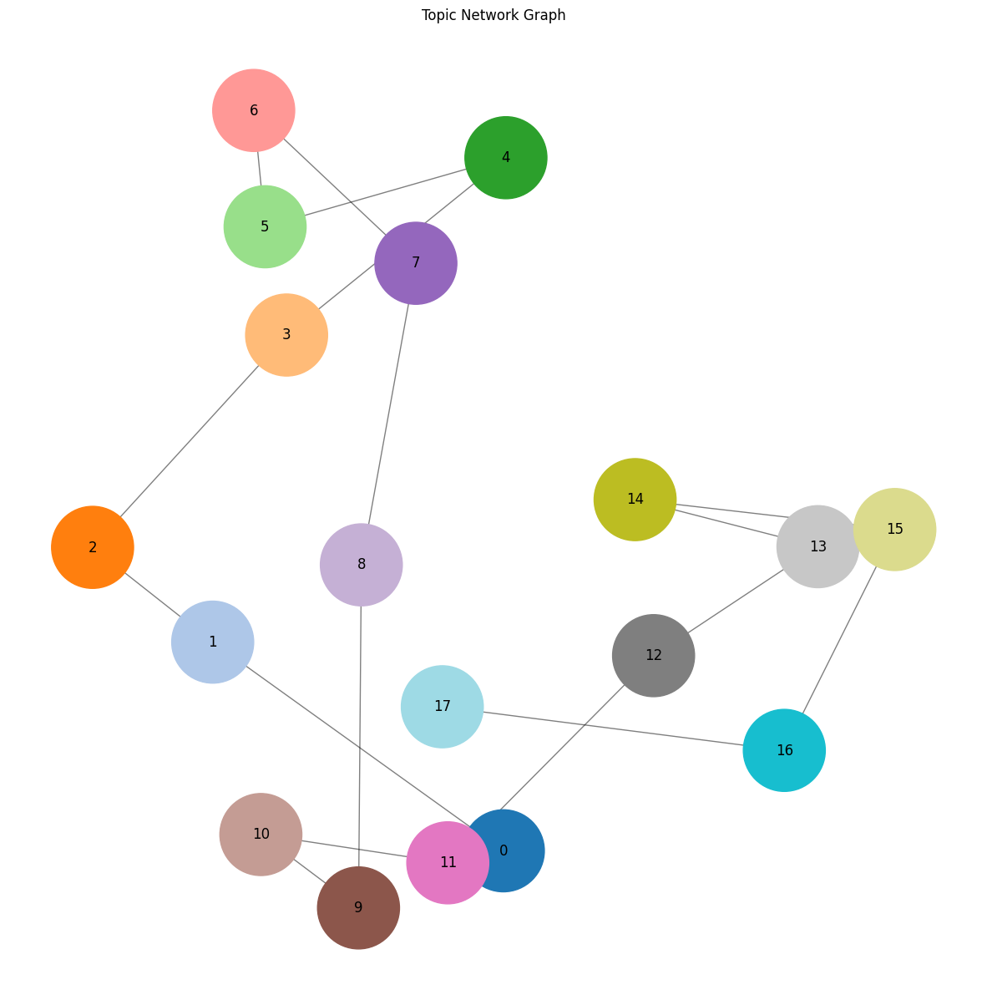

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
from bertopic import BERTopic
import numpy as np

# ... [rest of your code, assuming topic_model is already created and fitted] ...

# Get topic information
topic_info = topic_model.get_topic_info()

# Create a graph
G = nx.Graph()

# Add nodes, skipping the '-1' topic
for index, row in topic_info.iterrows():
    topic_id = row['Topic']
    if topic_id == -1:  # Skip the outlier topic
        continue
    G.add_node(topic_id)

# Define edges (this is a simple chain for demonstration; modify as needed)
topics = list(G.nodes)
for i in range(len(topics) - 1):
    G.add_edge(topics[i], topics[i + 1])

# Uniform node size
uniform_size = 5000  # You can adjust this value as needed

# Node colors
colors = plt.cm.tab20(np.linspace(0, 1, len(G.nodes)))

# Draw the graph
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, k=0.5, iterations=20)  # Layout for the nodes

nx.draw_networkx_nodes(G, pos, node_size=uniform_size, node_color=colors)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_labels(G, pos)

plt.title("Topic Network Graph")
plt.axis("off")
plt.show()

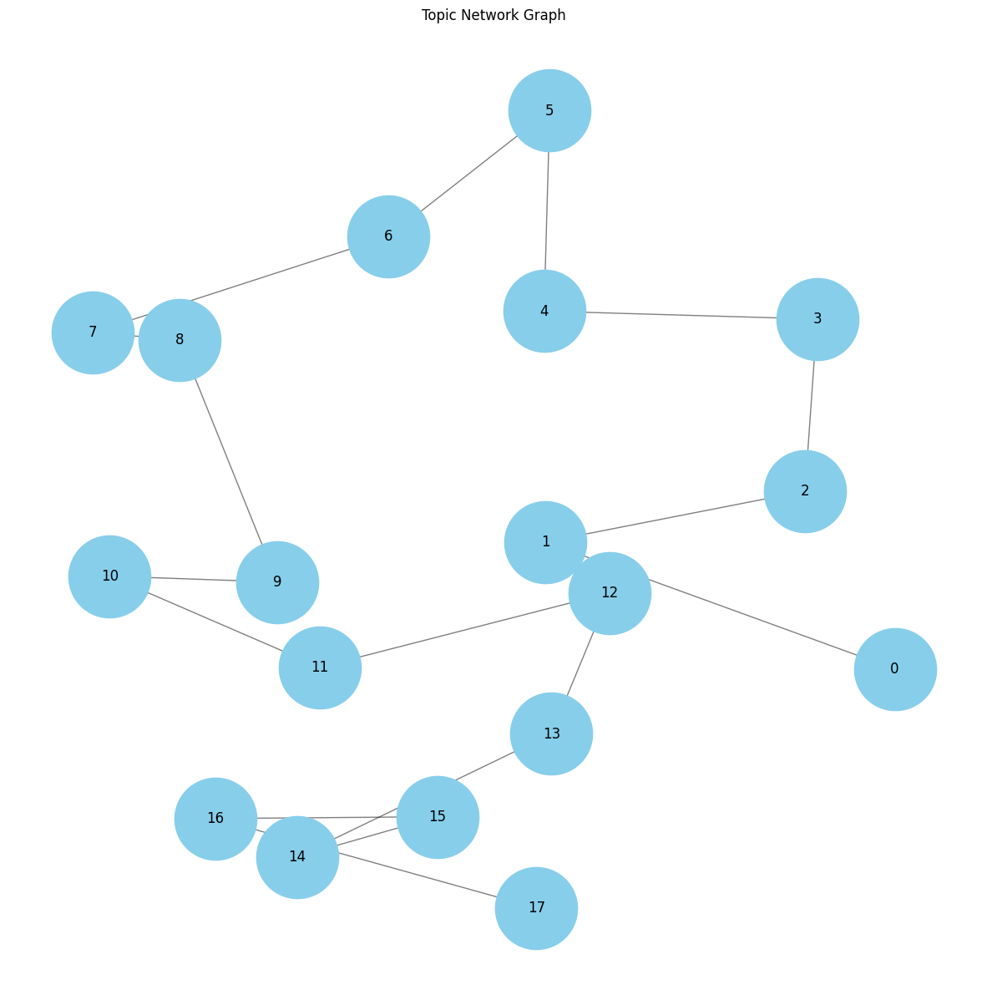

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
from bertopic import BERTopic
import numpy as np

# ... [rest of your code, assuming topic_model is already created and fitted] ...

# Get topic information
topic_info = topic_model.get_topic_info()

# Create a graph
G = nx.Graph()

# Add nodes, skipping the '-1' topic
for index, row in topic_info.iterrows():
    topic_id = row['Topic']
    if topic_id == -1:  # Skip the outlier topic
        continue
    G.add_node(topic_id)

# Define edges (this is a simple chain for demonstration; modify as needed)
topics = list(G.nodes)
for i in range(len(topics) - 1):
    G.add_edge(topics[i], topics[i + 1])

# Uniform node size
uniform_size = 5000  # You can adjust this value as needed

# Set a single color for all nodes
node_color = "skyblue"  # You can choose any color you like

# Draw the graph
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, k=0.5, iterations=20)  # Layout for the nodes

nx.draw_networkx_nodes(G, pos, node_size=uniform_size, node_color=node_color)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_labels(G, pos)

plt.title("Topic Network Graph")
plt.axis("off")
plt.show()


In [ ]:
import networkx as nx

# Assuming G is your graph

# Degree Centrality
degree_centrality = nx.degree_centrality(G)

# Betweenness Centrality
betweenness_centrality = nx.betweenness_centrality(G)

# Closeness Centrality
closeness_centrality = nx.closeness_centrality(G)

# Clustering Coefficient
clustering_coefficient = nx.clustering(G)

# Average Path Length (for connected graph)
if nx.is_connected(G):
    avg_path_length = nx.average_shortest_path_length(G)

# Print or analyze the metrics
print("Degree Centrality:", degree_centrality)
print("Betweenness Centrality:", betweenness_centrality)
print("Closeness Centrality:", closeness_centrality)
print("Clustering Coefficient:", clustering_coefficient)
if nx.is_connected(G):
    print("Average Path Length:", avg_path_length)


Degree Centrality: {'airdrop': 0.08035714285714285, 'bounty': 0.08035714285714285, 'coin': 0.15178571428571427, 'coins': 0.15178571428571427, 'ico': 0.4196428571428571, 'exchange': 0.15178571428571427, 'trading': 0.20535714285714285, 'crypto': 0.5535714285714285, 'eth': 0.08035714285714285, 'tokensale': 0.2857142857142857, 'blockchain': 0.3482142857142857, 'cash': 0.08035714285714285, 'currency': 0.08035714285714285, 'bitcoin': 0.2232142857142857, 'cryptocurrency': 0.5357142857142857, 'bank': 0.14285714285714285, 'payment': 0.08035714285714285, 'transfer': 0.08035714285714285, 'ethereum': 0.26785714285714285, 'entrepreneurs': 0.08035714285714285, 'cryptocurrencies': 0.19642857142857142, 'fintech': 0.1607142857142857, 'investments': 0.14285714285714285, 'venture': 0.08035714285714285, 'crowdfunding': 0.08035714285714285, 'augmentedreality': 0.08035714285714285, 'ar': 0.08035714285714285, 'vr': 0.08035714285714285, 'projects': 0.1607142857142857, 'technologies': 0.08035714285714285, 'tec

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
from itertools import combinations
import matplotlib.colors as mcolors

# Assume `topic_model` is your trained BERTopic instance
topic_info = topic_model.get_topic_info()
number_of_topics = len(topic_info) - 1  # excluding the outlier topic (-1)

# Build a dictionary to hold co-occurrence data
co_occurrence = {i: topic_model.get_topic(i) for i in range(number_of_topics)}

# Create a new graph
G = nx.Graph()

# Iterate over each topic to create the edges based on co-occurrence
for topic, words in co_occurrence.items():
    for (word1, _), (word2, _) in combinations(words, 2):
        if G.has_edge(word1, word2):
            G[word1][word2]['weight'] += 1
        else:
            G.add_edge(word1, word2, weight=1)

# Drawing the graph with high resolution
plt.figure(figsize=(12, 12), dpi=800)  # Increased DPI for high resolution
pos = nx.spring_layout(G, k=0.2, iterations=50)  # Improved layout

# Color palette
colors = plt.cm.plasma(np.linspace(0, 1, len(G.nodes())))

# Nodes
nx.draw_networkx_nodes(G, pos, node_color=colors, node_size=150, alpha=0.9)

# Edges
edge_weights = nx.get_edge_attributes(G, 'weight')
edges = nx.draw_networkx_edges(G, pos, edge_color='grey', alpha=0.5, width=[v * 0.1 for v in edge_weights.values()])

# Labels
nx.draw_networkx_labels(G, pos, font_size=10, font_family='sans-serif')

# Styling
plt.title('Topic Co-occurrence Network', fontsize=20, fontweight='bold')
plt.axis('off')
plt.show()

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from itertools import combinations

# Assume `topic_model` is your trained BERTopic instance
topic_info = topic_model.get_topic_info()
number_of_topics = len(topic_info) - 1  # excluding the outlier topic (-1)

# Build a dictionary to hold co-occurrence and topic data
co_occurrence = {i: topic_model.get_topic(i) for i in range(number_of_topics)}
word_to_topic = {word: topic for topic, words in co_occurrence.items() for word, _ in words}

# Create a new graph
G = nx.Graph()

# Iterate over each topic to create the edges based on co-occurrence
for topic, words in co_occurrence.items():
    for (word1, _), (word2, _) in combinations(words, 2):
        if G.has_edge(word1, word2):
            G[word1][word2]['weight'] += 1
        else:
            G.add_edge(word1, word2, weight=1)

# Assign a color for each topic
topic_colors = plt.cm.viridis(np.linspace(0, 1, number_of_topics))
node_colors = [topic_colors[word_to_topic[node]] if node in word_to_topic else 'grey' for node in G.nodes()]

# Drawing the graph with high resolution
plt.figure(figsize=(12, 12), dpi=800)  # Increased DPI for high resolution
pos = nx.spring_layout(G, k=0.2, iterations=50)  # Improved layout

# Nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=150, alpha=0.9)

# Edges
edge_weights = nx.get_edge_attributes(G, 'weight')
edges = nx.draw_networkx_edges(G, pos, edge_color='grey', alpha=0.5, width=[v * 0.1 for v in edge_weights.values()])

# Labels
nx.draw_networkx_labels(G, pos, font_size=10, font_family='sans-serif')

# Styling
plt.title('Topic Co-occurrence Network', fontsize=20, fontweight='bold')
plt.axis('off')
plt.show()


In [ ]:
!pip install gensim

In [ ]:
!pip install --upgrade gensim smart_open

In [ ]:
def topic_diversity(topics, top_n=10):
    unique_words = set()
    total_words = 0

    for topic in topics:
        unique_words.update(topic[:top_n])
        total_words += len(topic[:top_n])

    return len(unique_words) / total_words

# Extract top-n words for each topic
top_n_words = [topic_model.get_topic(topic_id)[:10] for topic_id in range(len(topic_model.get_topics()))]

# Calculate Topic Diversity
diversity = topic_diversity(top_n_words, top_n=10)
print("Topic Diversity:", diversity)


In [ ]:
# Visualize topics
topic_model.visualize_topics()

In [ ]:
topic_model.get_topic(-1)

[('cryptocurrency', 0.6304007),
 ('crypto', 0.62921506),
 ('blockchain', 0.5531671),
 ('ethereum', 0.5420952),
 ('bitcoin', 0.5377983),
 ('btc', 0.44015467),
 ('ecommerce', 0.42161196),
 ('ico', 0.41849512),
 ('coin', 0.36765128),
 ('tokens', 0.3639257)]

In [ ]:
topic_model.get_topic(0)

[('airdrop', 0.52475166),
 ('bounty', 0.40652683),
 ('coin', 0.38111612),
 ('coins', 0.35882068),
 ('ico', 0.3480441),
 ('exchange', 0.34477788),
 ('trading', 0.3057775),
 ('crypto', 0.3032269),
 ('eth', 0.29291028),
 ('tokensale', 0.28591743)]

In [ ]:
topic_model.get_topic(1)

[('exchange', 0.5162177),
 ('blockchain', 0.51034665),
 ('cash', 0.4910268),
 ('currency', 0.45095518),
 ('bitcoin', 0.42810452),
 ('cryptocurrency', 0.42683828),
 ('bank', 0.4145496),
 ('crypto', 0.3886345),
 ('payment', 0.38264707),
 ('transfer', 0.36490202)]

In [ ]:
topic_model.get_topic(2)

[('crypto', 0.57619643),
 ('ethereum', 0.54119885),
 ('entrepreneurs', 0.5202984),
 ('cryptocurrencies', 0.50184125),
 ('fintech', 0.49771145),
 ('cryptocurrency', 0.49115652),
 ('bitcoin', 0.4884225),
 ('investments', 0.4845818),
 ('venture', 0.48153186),
 ('crowdfunding', 0.4585337)]

In [ ]:
topic_model.get_topic(3)

[('augmentedreality', 0.7850077),
 ('ar', 0.42416316),
 ('vr', 0.41691858),
 ('projects', 0.36812878),
 ('technologies', 0.34032106),
 ('technology', 0.33778942),
 ('virtual', 0.33696622),
 ('ico', 0.3331533),
 ('innovative', 0.31989905),
 ('idea', 0.3048191)]

In [ ]:
topic_model.get_topic(4)

[('btc', 0.550419),
 ('crypto', 0.5380783),
 ('cryptocurrency', 0.49359456),
 ('cryptocurrencies', 0.46546048),
 ('bitcoin', 0.46043462),
 ('trading', 0.41120166),
 ('ethereum', 0.40407282),
 ('traders', 0.40139621),
 ('blockchain', 0.38653082),
 ('altcoins', 0.38322833)]

In [ ]:
topic_model.get_topic(5)

[('token', 0.565846),
 ('tokens', 0.5189488),
 ('tokensale', 0.49766853),
 ('free', 0.4020383),
 ('click', 0.32696712),
 ('started', 0.30820608),
 ('got', 0.26667473),
 ('download', 0.26005286),
 ('user', 0.25897264),
 ('available', 0.24737582)]

In [ ]:
topic_model.get_topic(6)

[('blockchain', 0.60941327),
 ('music', 0.5780058),
 ('ethereum', 0.46300495),
 ('bitcoin', 0.4518999),
 ('cryptocurrency', 0.40156037),
 ('crypto', 0.35967806),
 ('content', 0.2784416),
 ('decentralized', 0.2682616),
 ('platform', 0.26706323),
 ('media', 0.24031523)]

In [ ]:
topic_model.get_topic(7)

[('ico', 0.3997065),
 ('crypto', 0.2778234),
 ('services', 0.2723628),
 ('register', 0.25021267),
 ('economy', 0.2455931),
 ('presale', 0.24011043),
 ('decentralized', 0.23239093),
 ('bank', 0.2314627),
 ('cryptocurrency', 0.2245706),
 ('consumer', 0.20179638)]

In [ ]:
topic_model.get_topic(8)

[('health', 0.48585492),
 ('healthcare', 0.37447715),
 ('benefits', 0.30996692),
 ('increase', 0.21363285),
 ('services', 0.19455808),
 ('innovation', 0.18741064),
 ('care', 0.18006629),
 ('innovative', 0.17549554),
 ('support', 0.17501113),
 ('helps', 0.1699613)]

In [ ]:
topic_model.get_topic(9)

[('ico', 0.70500976),
 ('project', 0.5806892),
 ('crypto', 0.37720174),
 ('development', 0.32279742),
 ('creating', 0.31813514),
 ('artificial', 0.30876517),
 ('activities', 0.3075542),
 ('promising', 0.30033162),
 ('organized', 0.29693395),
 ('glad', 0.28438962)]

In [ ]:
topic_model.get_topic(10)

[('cannabis', 0.73494536),
 ('health', 0.33980608),
 ('grow', 0.24854237),
 ('growing', 0.23584285),
 ('products', 0.23211744),
 ('benefits', 0.22220577),
 ('promising', 0.20052695),
 ('research', 0.19946288),
 ('supply', 0.19848168),
 ('taking', 0.19555405)]

In [ ]:
topic_model.get_topic(11)

[('commodities', 0.61909723),
 ('commodity', 0.57464975),
 ('trading', 0.45600694),
 ('decentralized', 0.38551062),
 ('ethereum', 0.34699345),
 ('market', 0.34618148),
 ('cryptocurrency', 0.34430826),
 ('blockchain', 0.3150444),
 ('investments', 0.3045246),
 ('industry', 0.28171158)]

In [ ]:
topic_model.get_topic(12)

[('tokensale', 0.5273931),
 ('cryptocurrency', 0.44094223),
 ('token', 0.42770392),
 ('currencies', 0.42578632),
 ('tokens', 0.40637997),
 ('cryptocurrencies', 0.40598345),
 ('sale', 0.38596028),
 ('registered', 0.38422424),
 ('buy', 0.37787062),
 ('usd', 0.3723541)]

In [ ]:
topic_model.get_topic(13)

[('discount', 0.5204489),
 ('crypto', 0.42932773),
 ('blockchain', 0.42665595),
 ('listing', 0.42422283),
 ('cryptocurrency', 0.40804923),
 ('price', 0.37547815),
 ('market', 0.36501914),
 ('tokensale', 0.35991186),
 ('selling', 0.35364985),
 ('opportunity', 0.33465916)]

In [ ]:
topic_model.get_topic(14)

[('ieo', 0.43582118),
 ('exchanges', 0.41096276),
 ('crypto', 0.29735395),
 ('market', 0.2777993),
 ('month', 0.26968044),
 ('early', 0.2672721),
 ('ico', 0.26709008),
 ('marketplace', 0.26408702),
 ('opportunities', 0.25684524),
 ('reward', 0.24433278)]

In [ ]:
topic_model.get_topic(15)

[('fintech', 0.29401213),
 ('retweet', 0.28357452),
 ('media', 0.27975047),
 ('twitter', 0.2525519),
 ('technology', 0.25210392),
 ('following', 0.23830467),
 ('participate', 0.22739385),
 ('development', 0.19948035),
 ('based', 0.19725442),
 ('explained', 0.19026469)]

In [ ]:
topic_model.get_topic(16)

[('lottery', 0.5076884),
 ('blockchain', 0.33800542),
 ('coins', 0.3365364),
 ('coin', 0.31047207),
 ('tokens', 0.29778898),
 ('cryptocurrency', 0.2919308),
 ('crowdsale', 0.28604078),
 ('projects', 0.25166062),
 ('token', 0.23361969),
 ('prize', 0.2324403)]

In [ ]:
topic_model.get_topic(17)

[('ico', 0.4755792),
 ('icos', 0.4718991),
 ('crypto', 0.3644055),
 ('icosale', 0.33853602),
 ('project', 0.30489028),
 ('ambitious', 0.30184138),
 ('promising', 0.28919733),
 ('cryptocurrency', 0.28739113),
 ('ethereum', 0.2547102),
 ('amazing', 0.2535093)]

In [ ]:
topic_model.get_topic(18)

In [ ]:
# Calculate the topic distributions on a token-level
topic_distr, topic_token_distr = topic_model.approximate_distribution(docs, calculate_tokens=True)

# Visualize the token-level distributions
df = topic_model.visualize_approximate_distribution(docs[1], topic_token_distr[1])
df

100%|██████████| 550/550 [02:13<00:00,  4.11it/s]


,award,winning,blockchain,music,tech,explainer,video,project,softcap,reached
2_crypto_ethereum_entrepreneurs_cryptocurrencies,0.000,0.117,0.284,0.409,0.555,0.438,0.271,0.146,0.000,0.000
6_blockchain_music_ethereum_bitcoin,0.517,0.960,1.528,1.982,1.465,1.022,0.454,0.000,0.000,0.000
15_fintech_retweet_media_twitter,0.000,0.000,0.000,0.175,0.380,0.674,0.844,0.669,0.464,0.170
16_lottery_blockchain_coins_coin,0.241,0.445,0.736,0.968,0.727,0.523,0.231,0.000,0.000,0.000


In [ ]:
topic_model.visualize_barchart(top_n_topics=20)

In [ ]:
topic_model.visualize_barchart(top_n_topics=30, height=350)

In [ ]:
topics_over_time = topic_model.topics_over_time(docs=docs,
                                                timestamps=timestamps,
                                                global_tuning=True,
                                                evolution_tuning=True,
                                                nr_bins=10)

10it [00:10,  1.01s/it]


In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=18)

In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[0,1,2,3,4,5,6,7,8,9])

In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[10,11,12,13,14,15,16,17])

In [ ]:
topics_over_time = topic_model.topics_over_time(docs=docs,
                                                timestamps=timestamps,
                                                global_tuning=True,
                                                evolution_tuning=True,
                                                nr_bins=50)

50it [00:21,  2.28it/s]


In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=18)

In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[0,1,2,3,4,5,6,7,8,9])

In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[10,11,12,13,14,15,16,17])

In [ ]:
topic_model.visualize_heatmap(n_clusters=10, top_n_topics=18)

In [ ]:
topic_model.visualize_heatmap()

In [ ]:
topic_model.visualize_term_rank()

In [ ]:
topic_model.visualize_term_rank(log_scale=True)

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install wordcloud

In [ ]:
from wordcloud import WordCloud

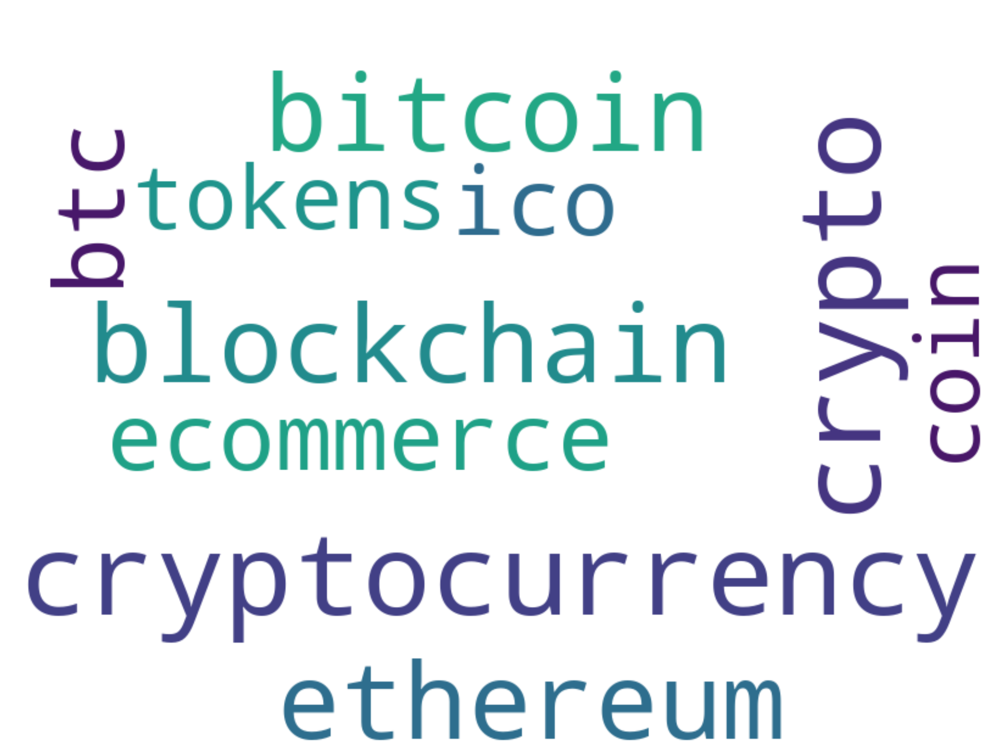

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=-1)


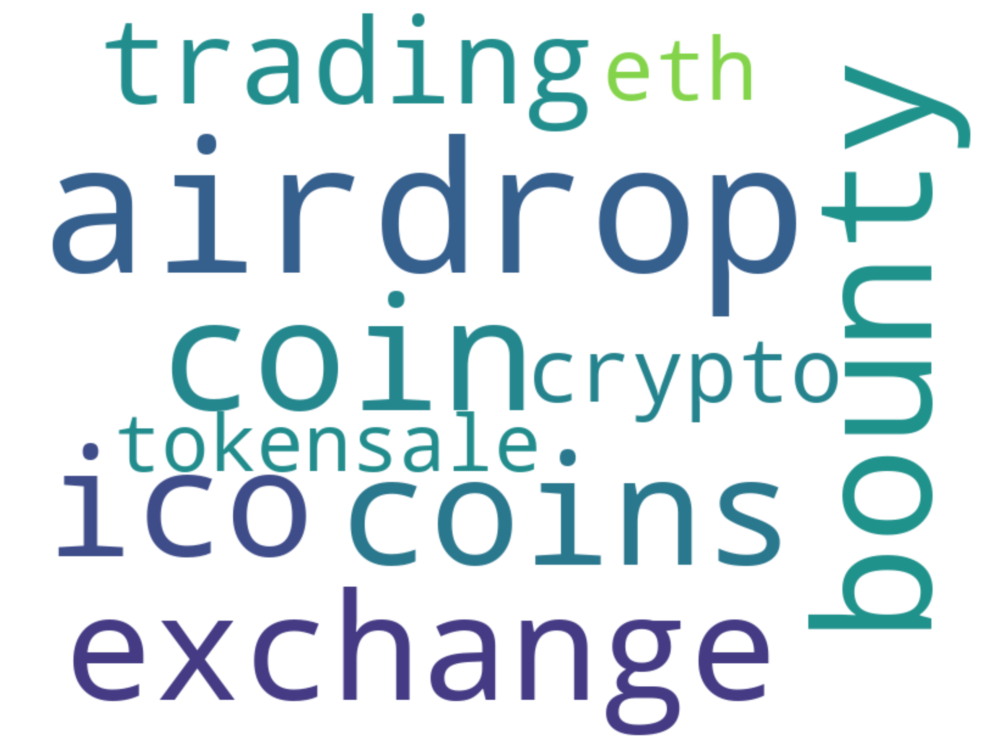

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=0)


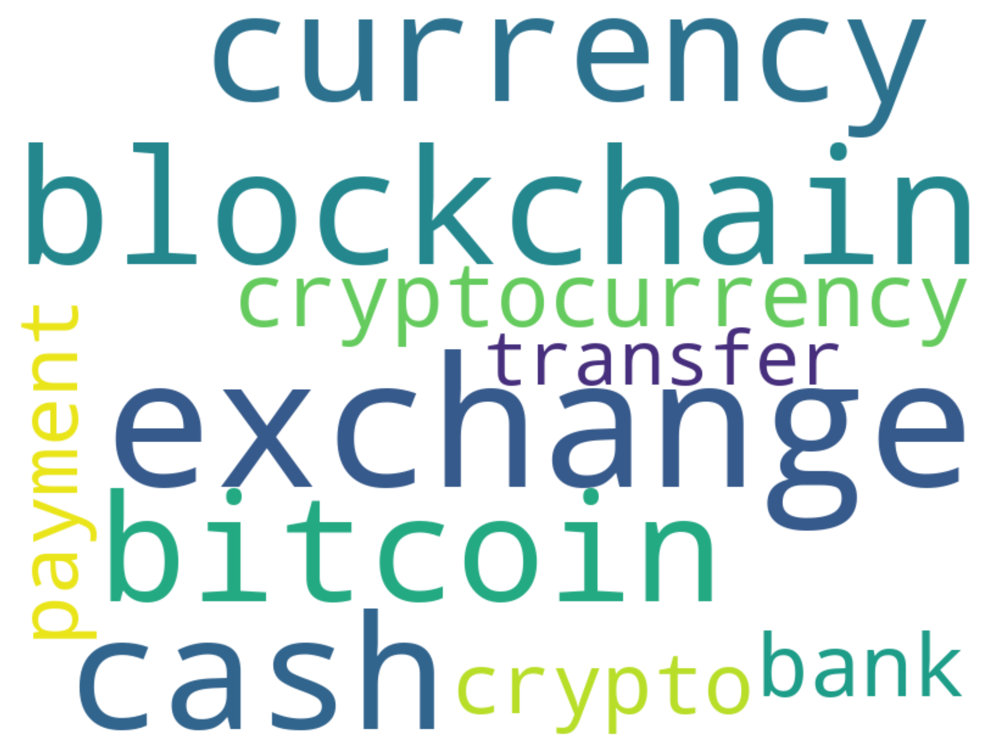

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=1)


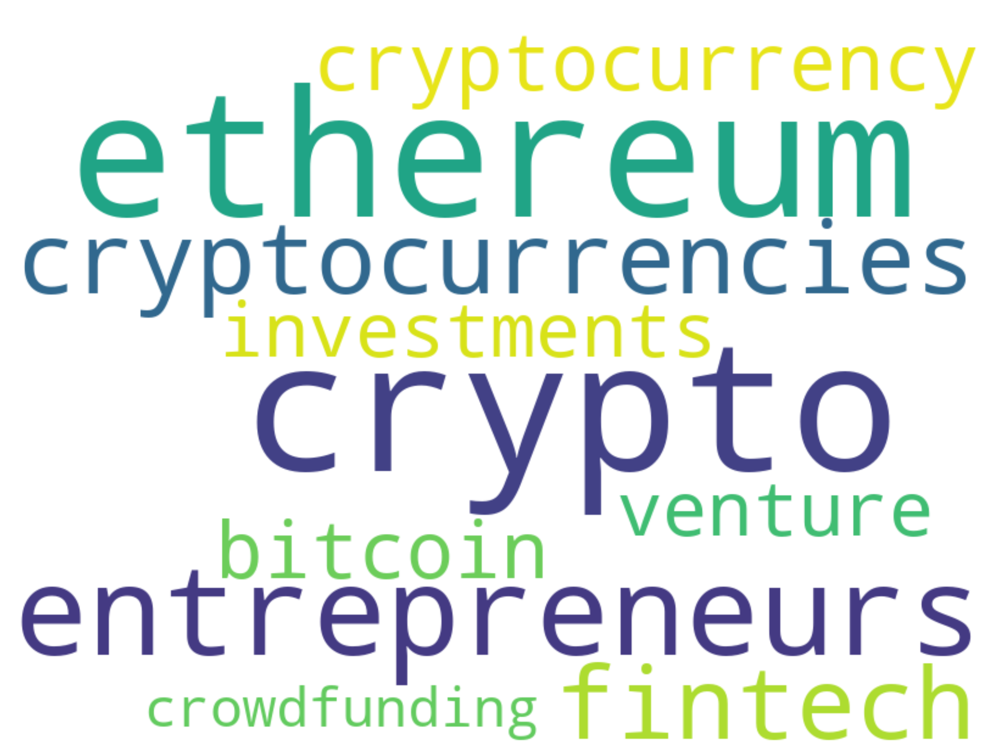

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=2)


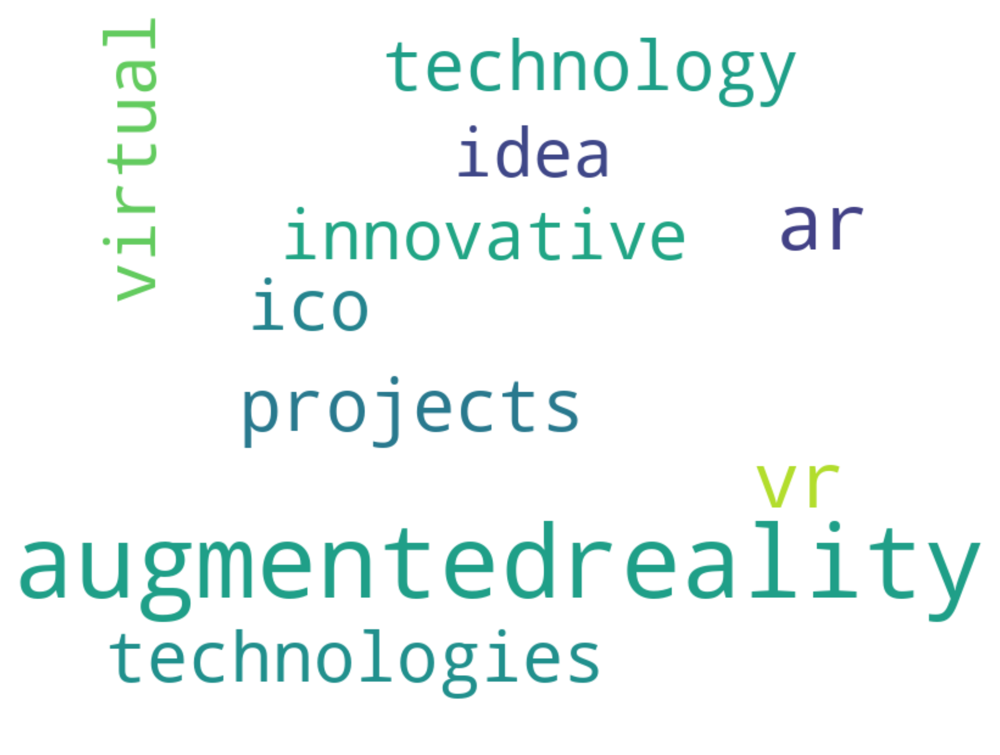

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=3)


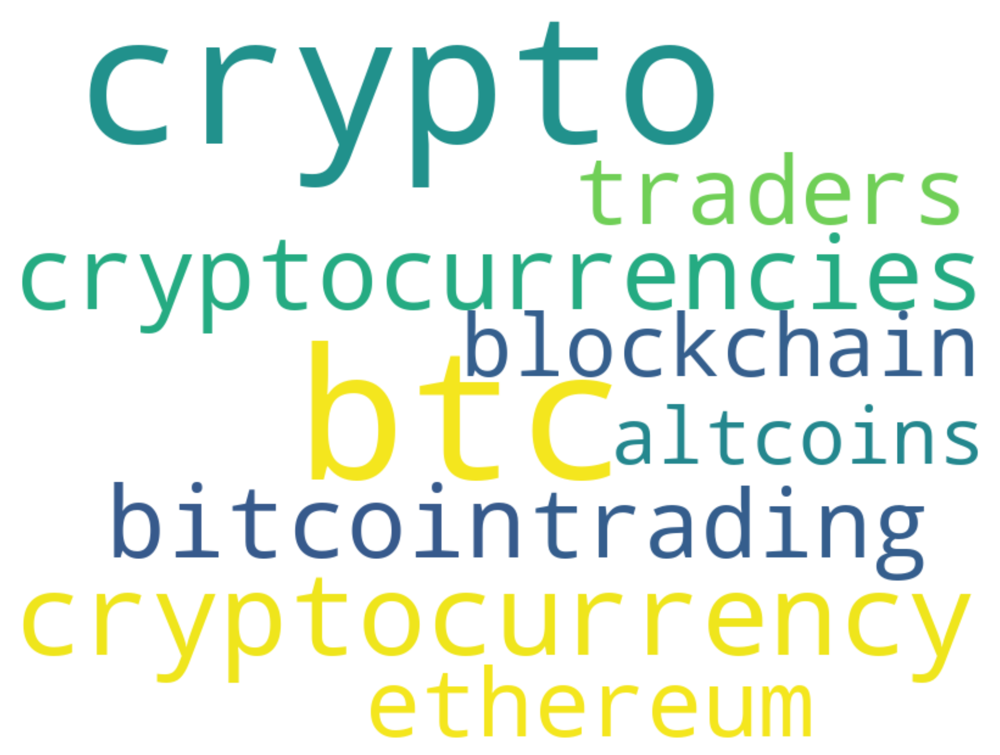

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=4)


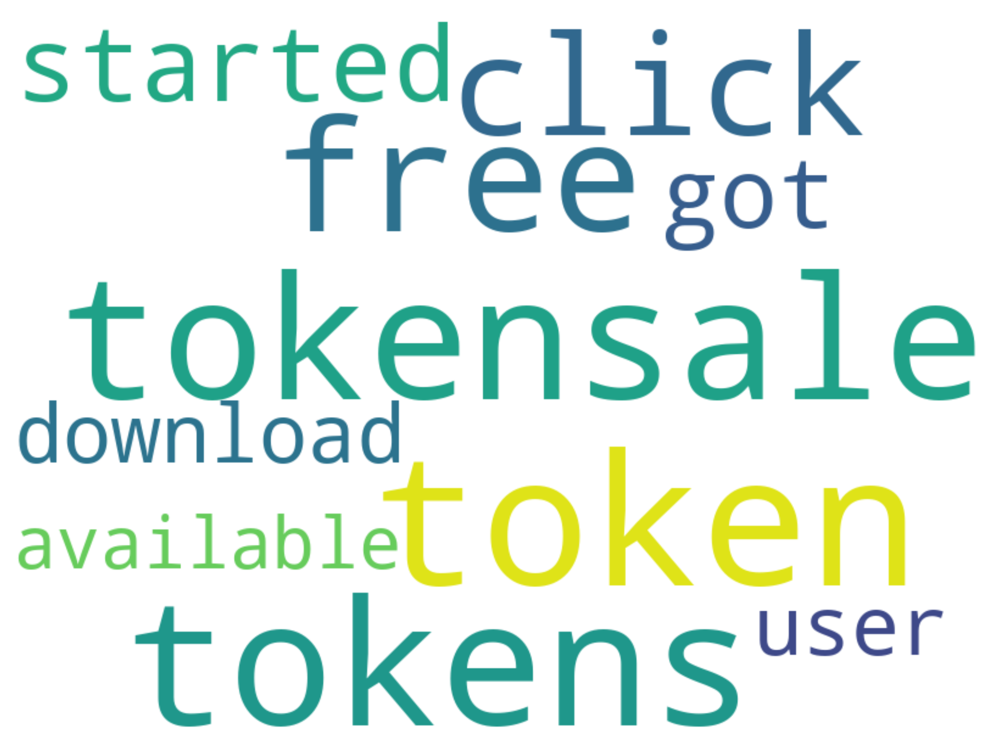

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=5)


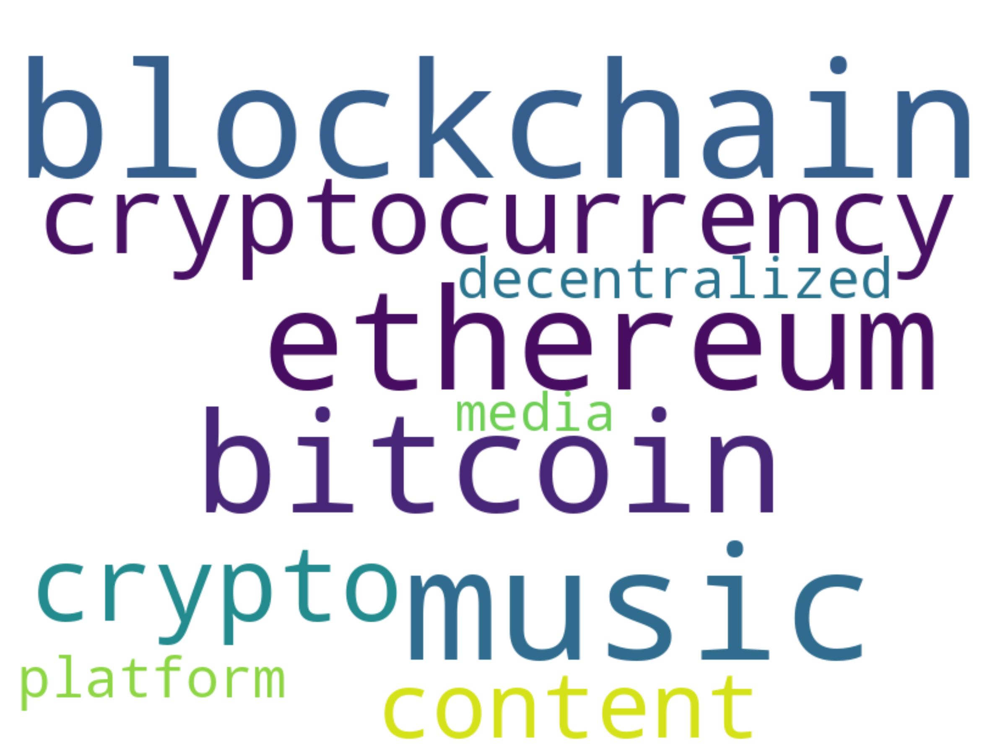

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=6)


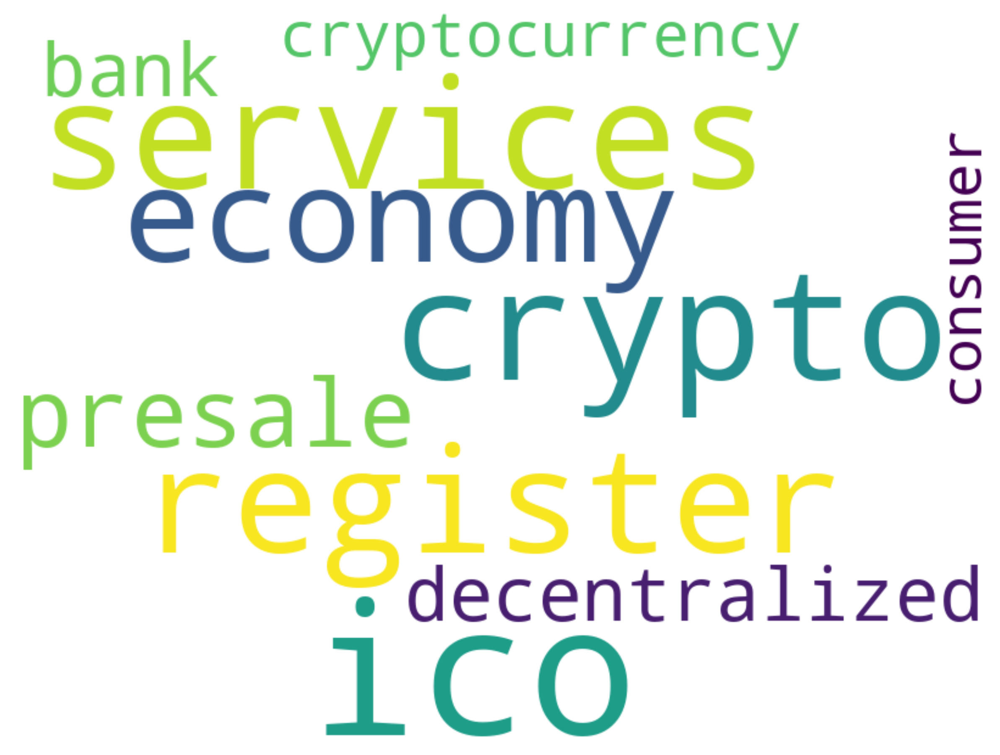

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=7)


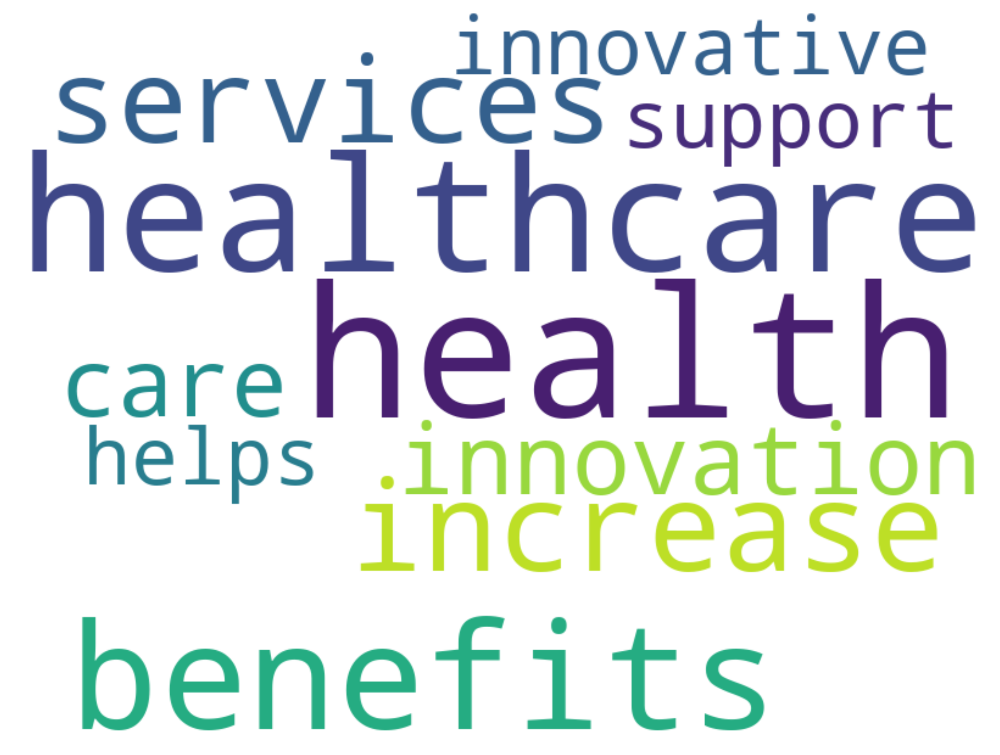

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=8)


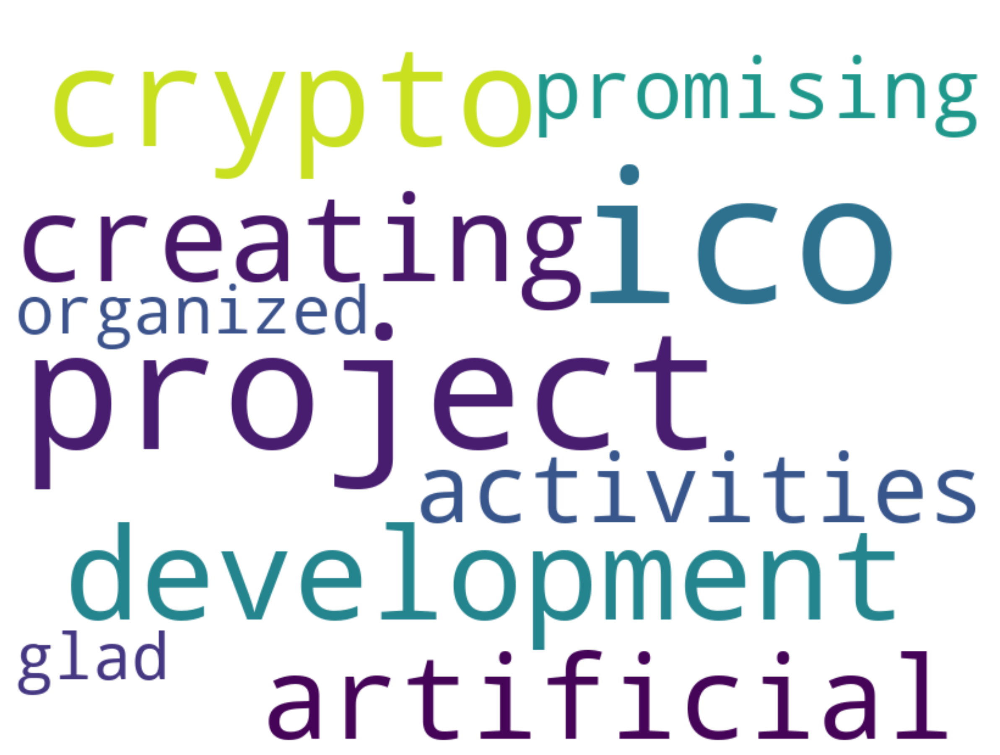

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=9)


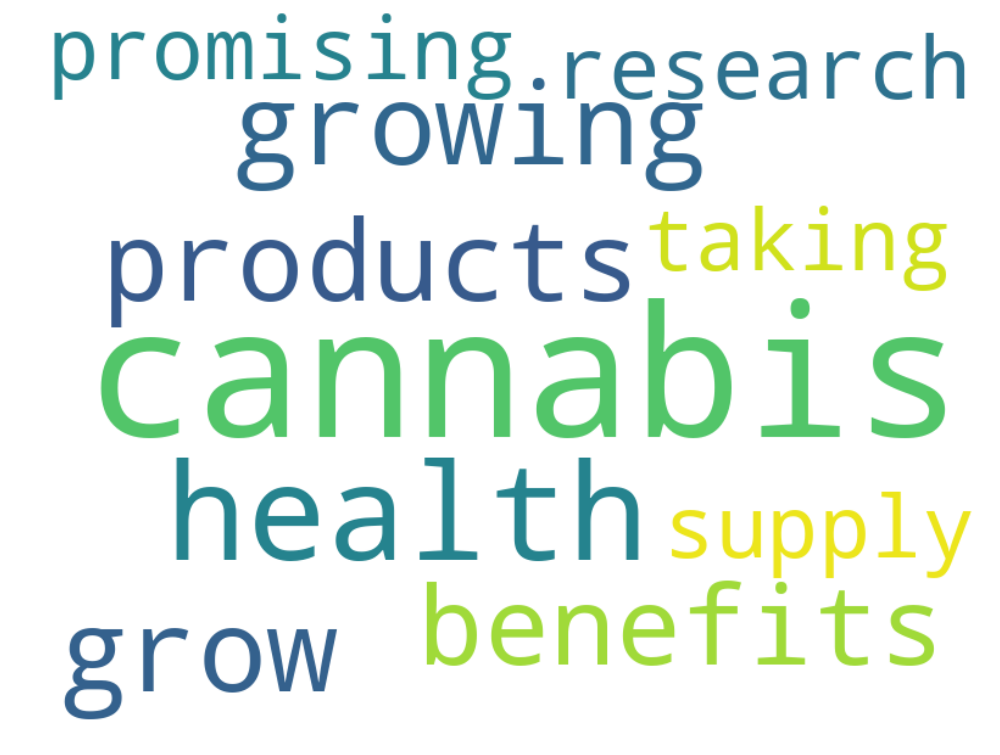

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=10)


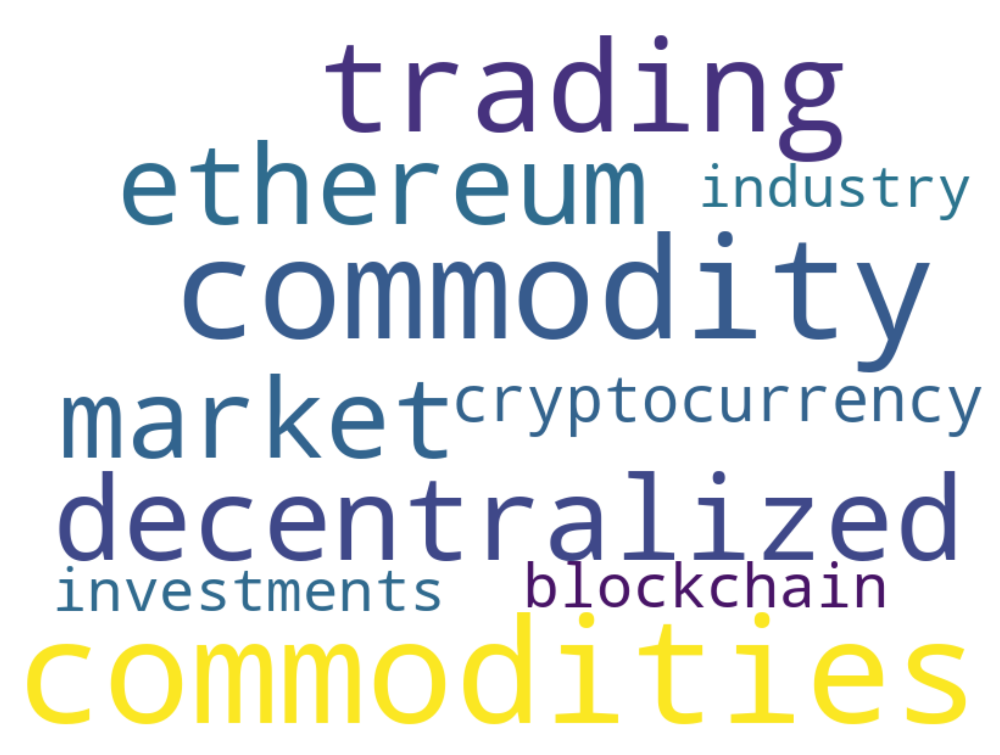

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=11)


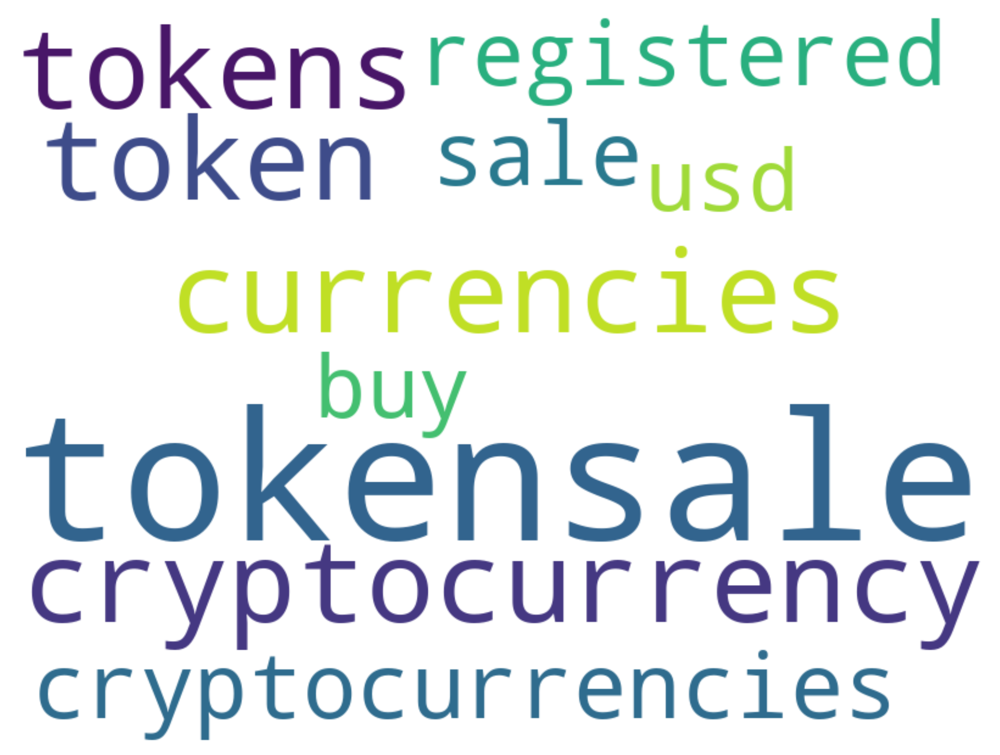

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=12)


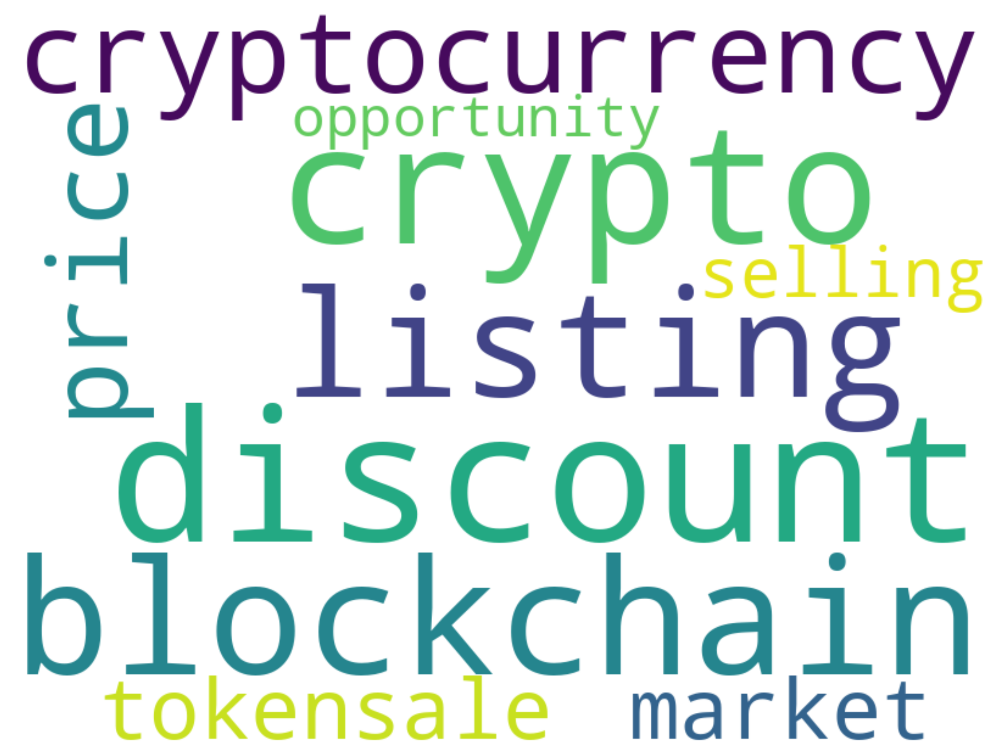

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=13)


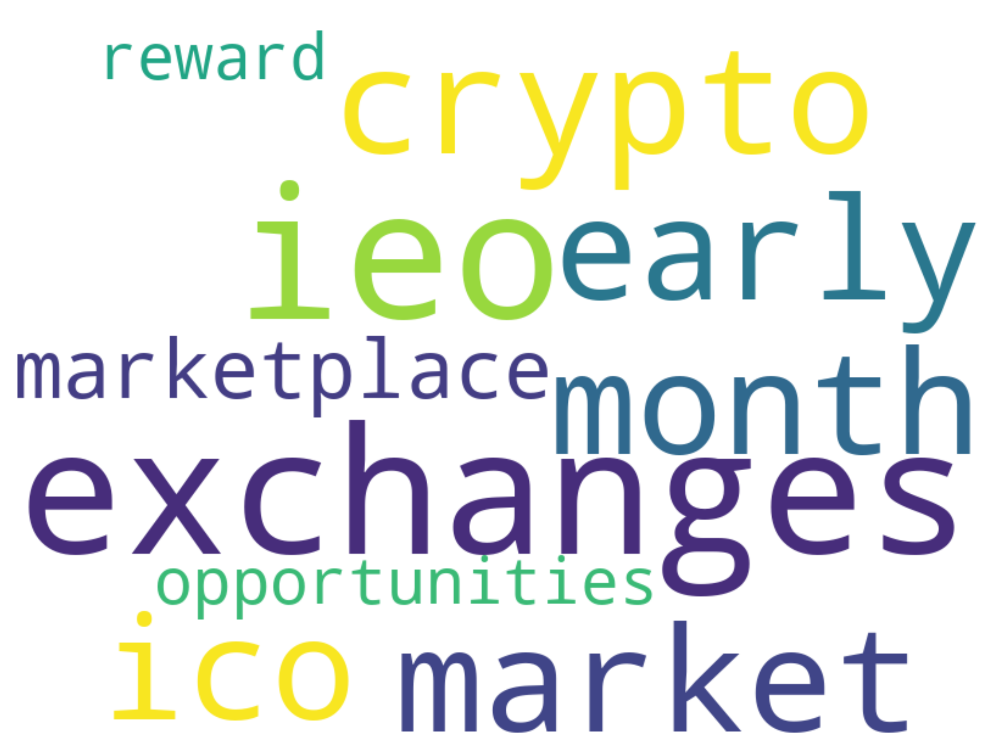

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=14)


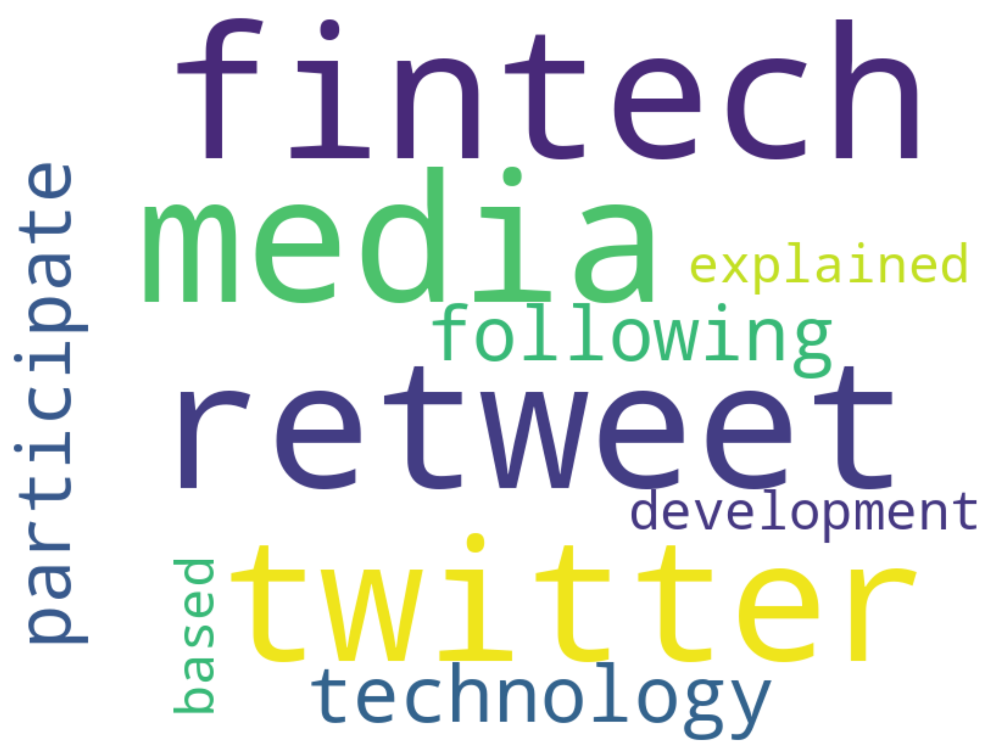

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=15)


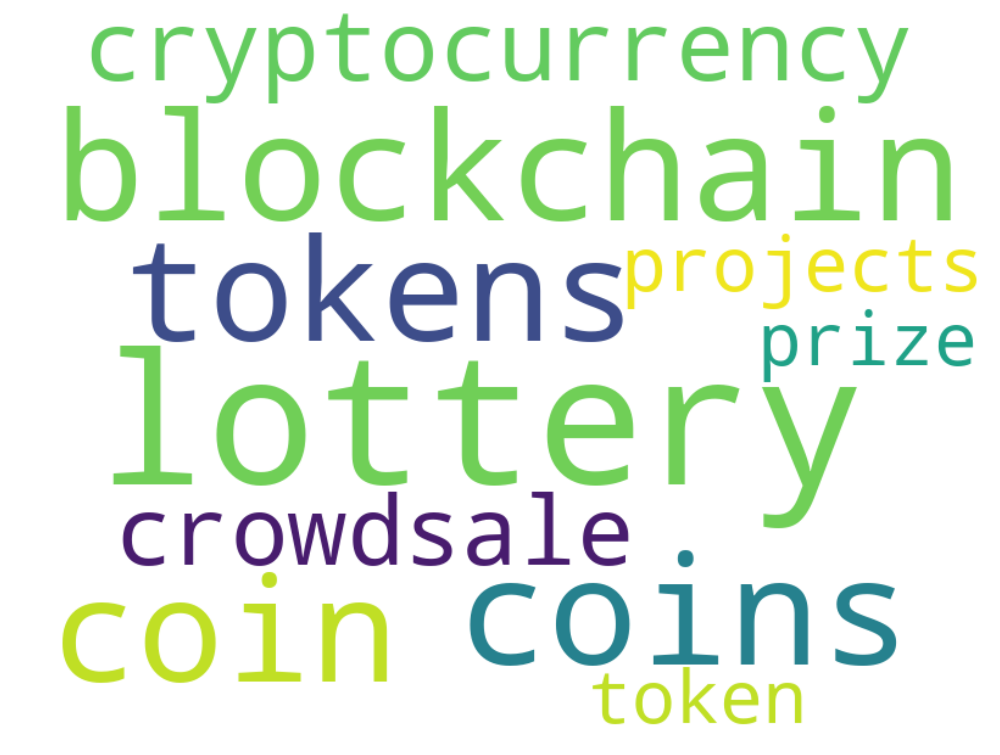

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=16)


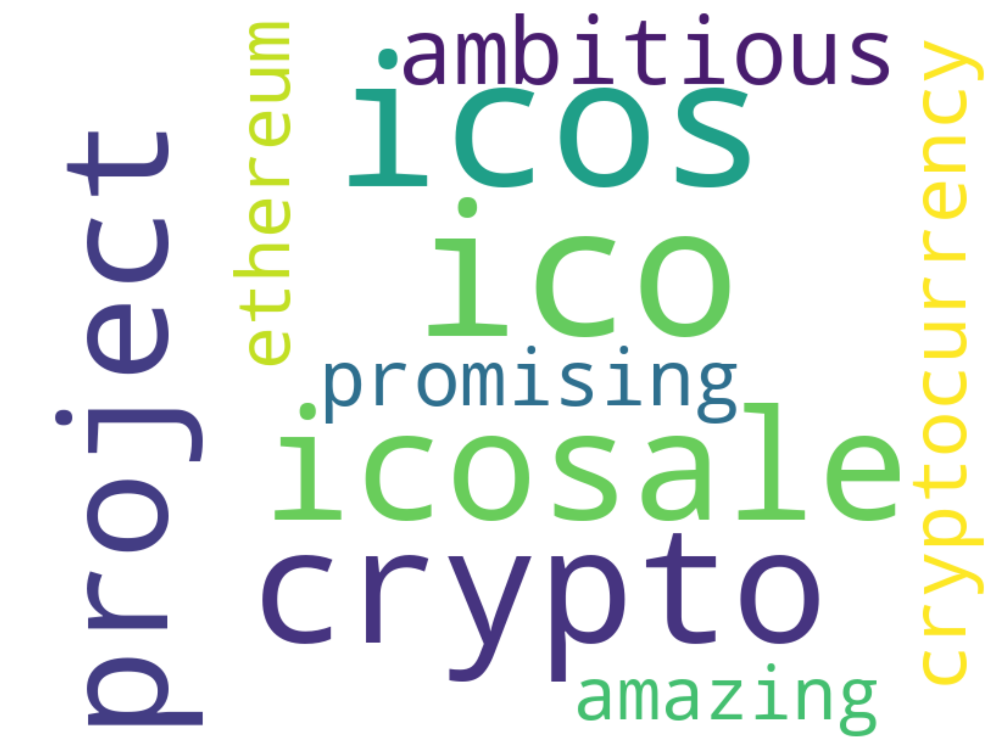

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=17)


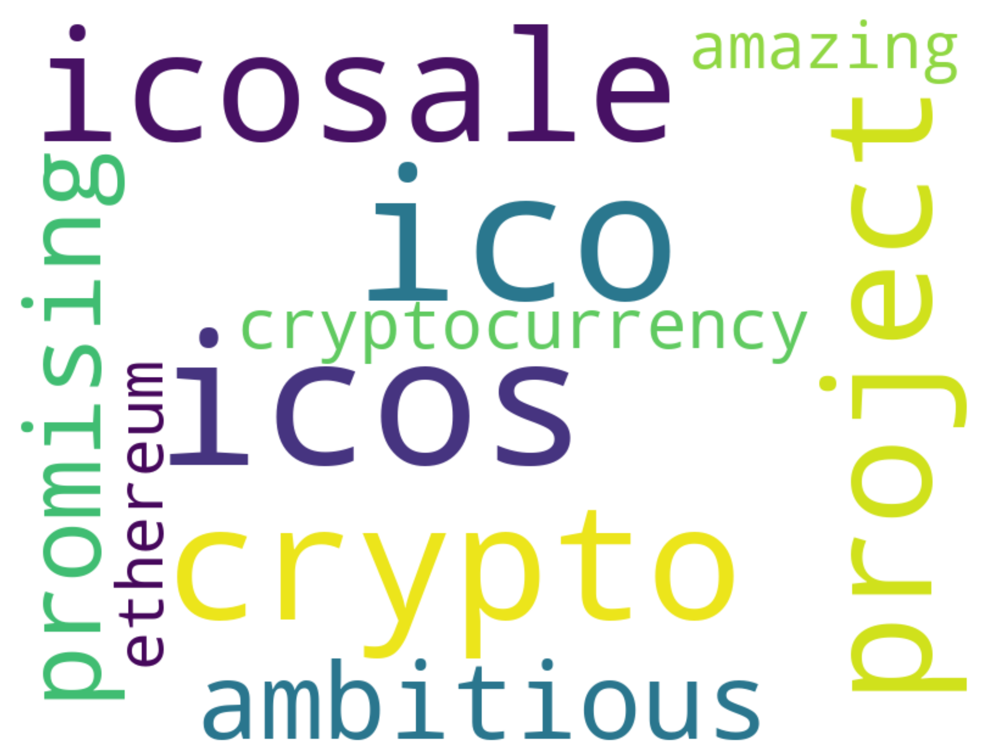

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def create_wordcloud(model, topic):
    # Retrieve word frequencies for the specified topic
    text = {word: value for word, value in model.get_topic(topic)}

    # Create a word cloud object with custom parameters
    wc = WordCloud(
        background_color="white",
        max_words=1000,
        width=800,  # Width of the canvas
        height=600,  # Height of the canvas
        max_font_size=150,  # Maximum font size for the largest word
        min_font_size=10,  # Minimum font size for the smallest word
        colormap='viridis'  # Color map for the words
    )

    # Generate word cloud
    wc.generate_from_frequencies(text)

    # Set the figure size and DPI for high resolution
    plt.figure(figsize=(10, 8), dpi=300)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=17)


In [ ]:
def create_wordcloud(model, topic):
    text = {word: value for word, value in model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=0)

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def create_wordcloud(model, topic):
    text = {word: value for word, value in model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
create_wordcloud(topic_model, topic=1)

In [ ]:


# Method 1 - safetensors
embedding_model = "sentence-transformers/all-MiniLM-L6-v2"
topic_model.save("/content/model_safetensors", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

# Method 2 - pytorch
topic_model.save("/content/model_pytorch", serialization="pytorch", save_ctfidf=True, save_embedding_model=embedding_model)

# Method 3 - pickle
topic_model.save("/content/my_model", serialization="pickle")


2024-01-05 14:14:31,220 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.
